# Question 1

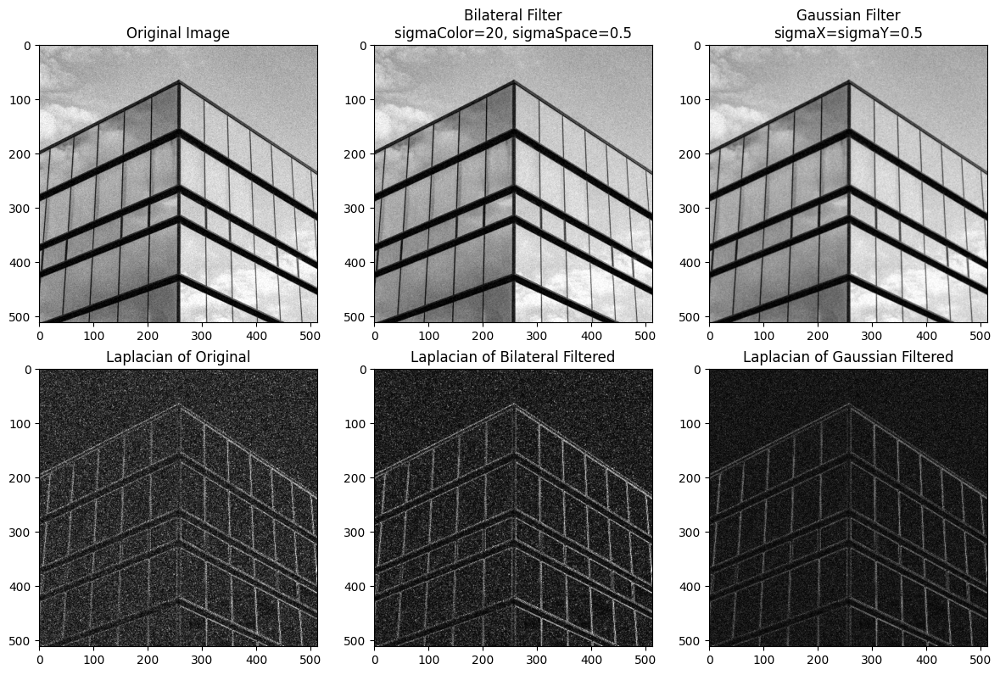

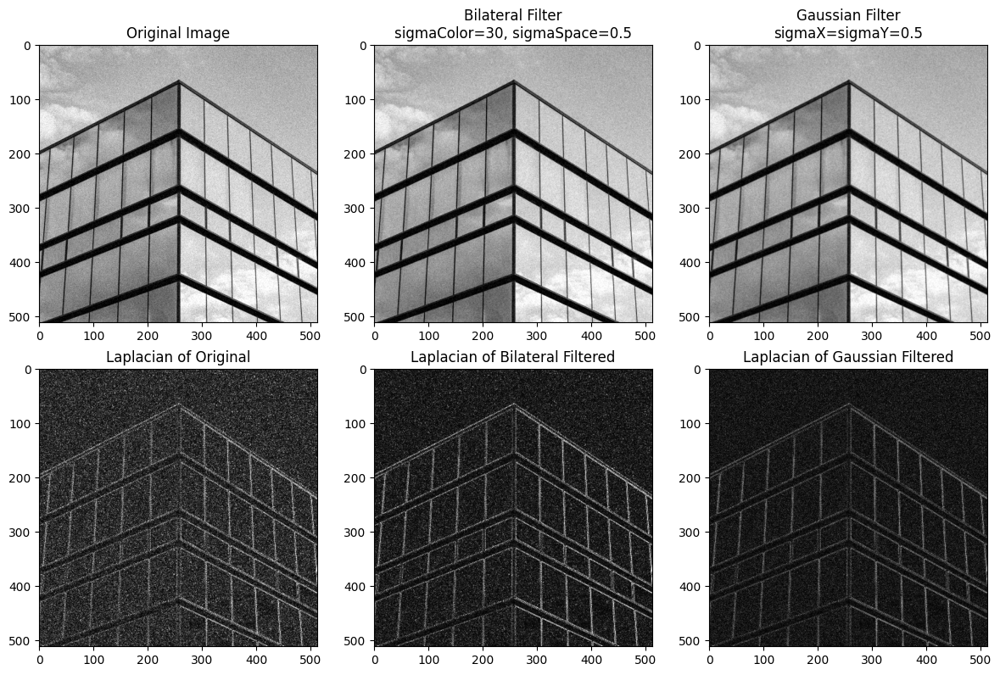

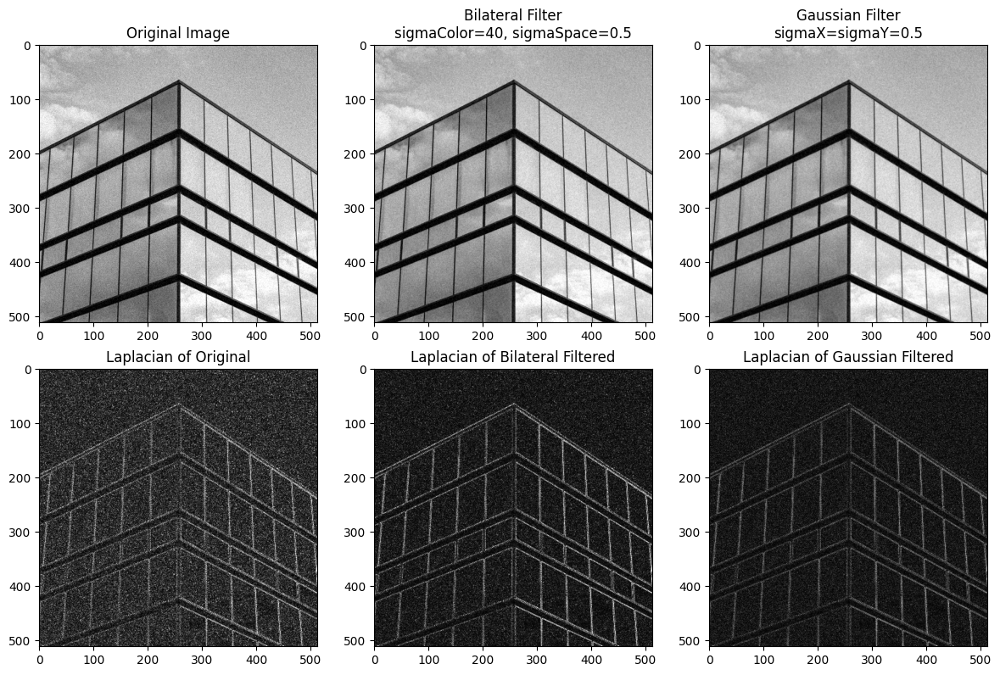

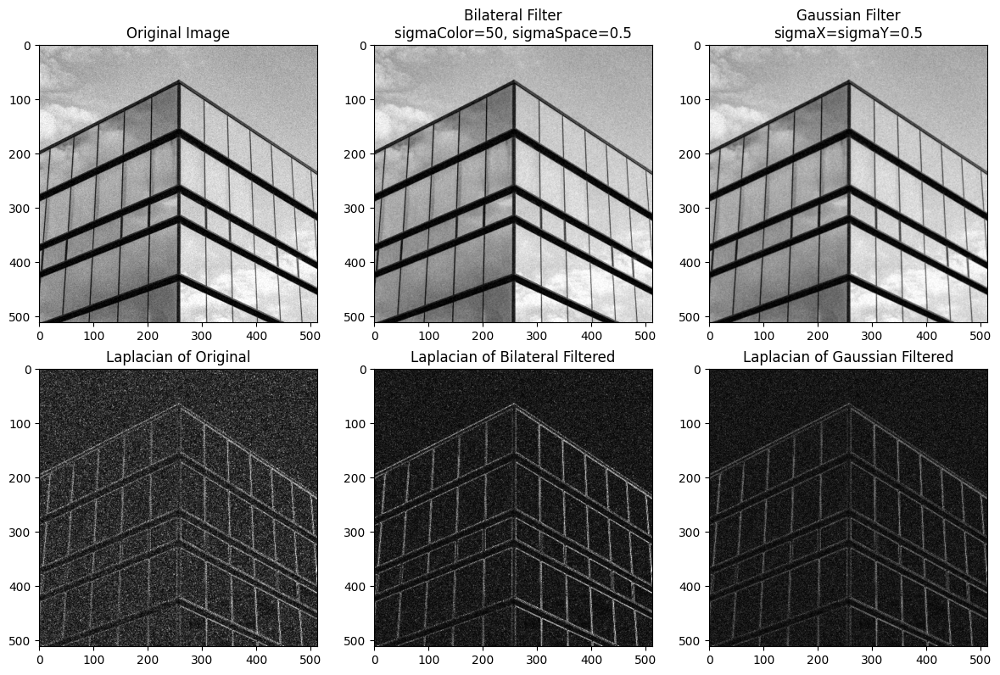

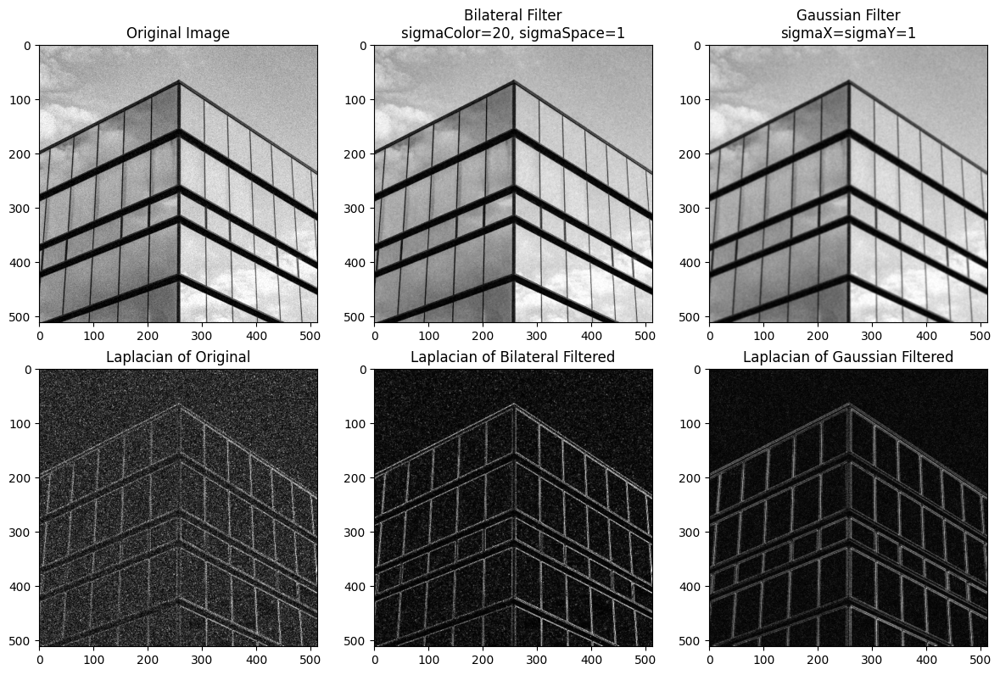

...

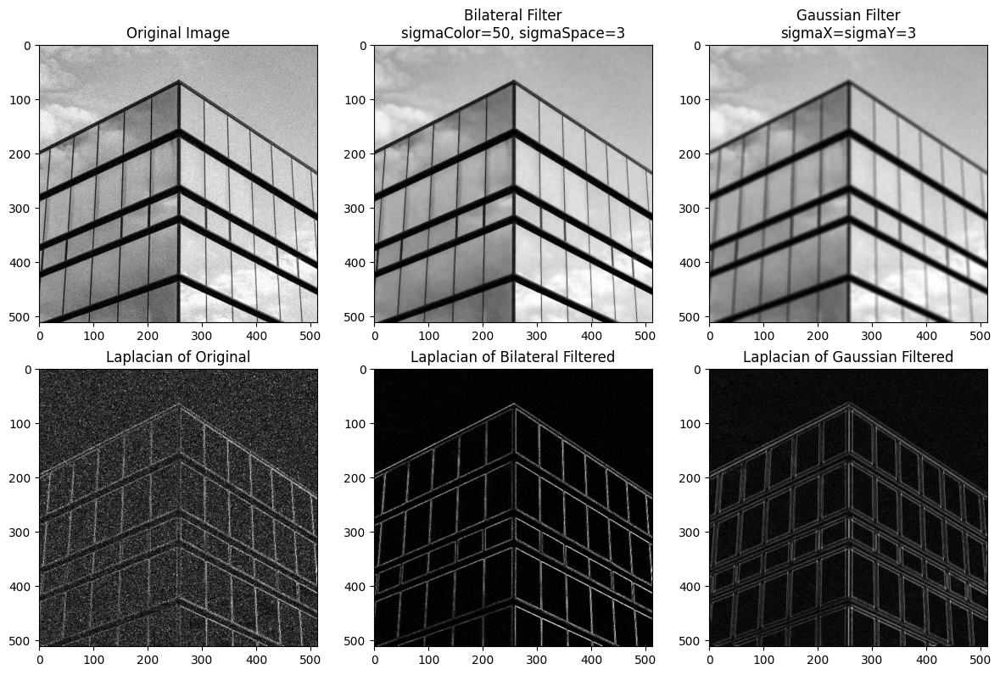

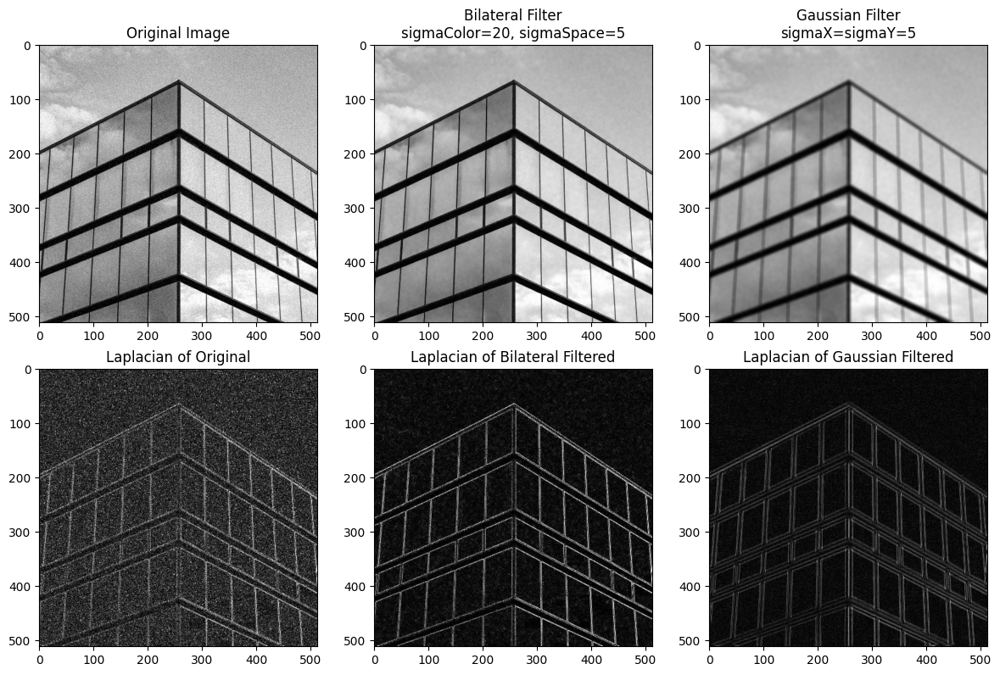

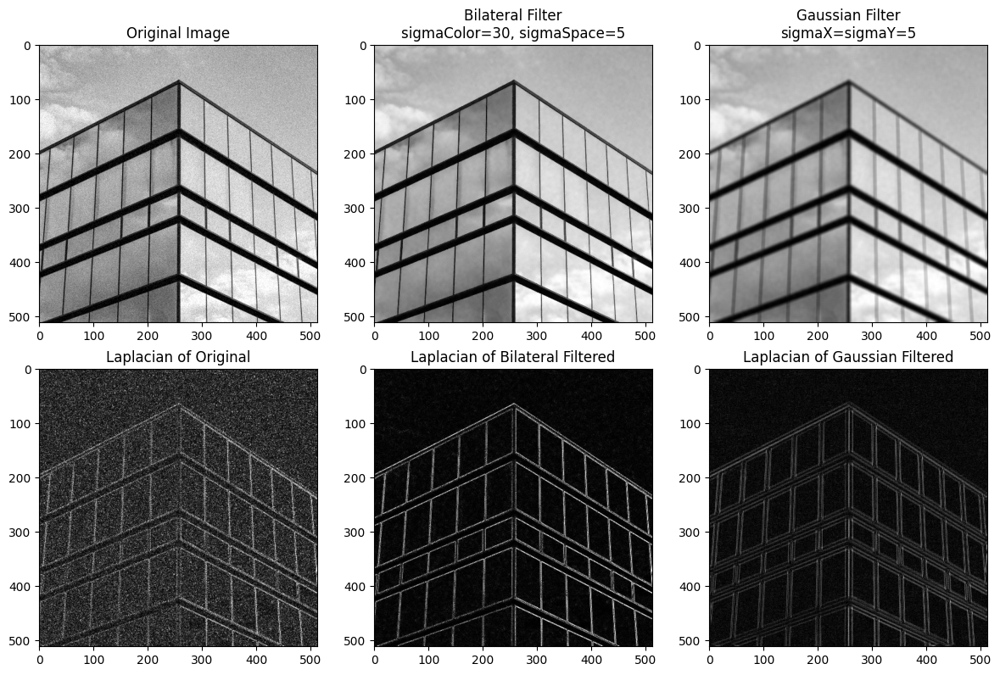

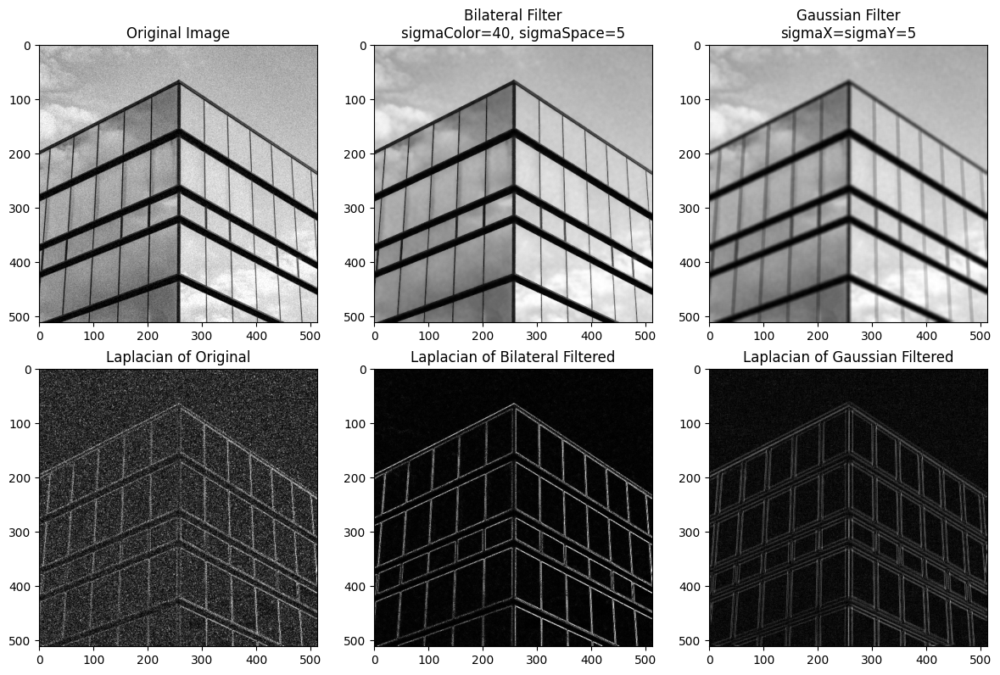

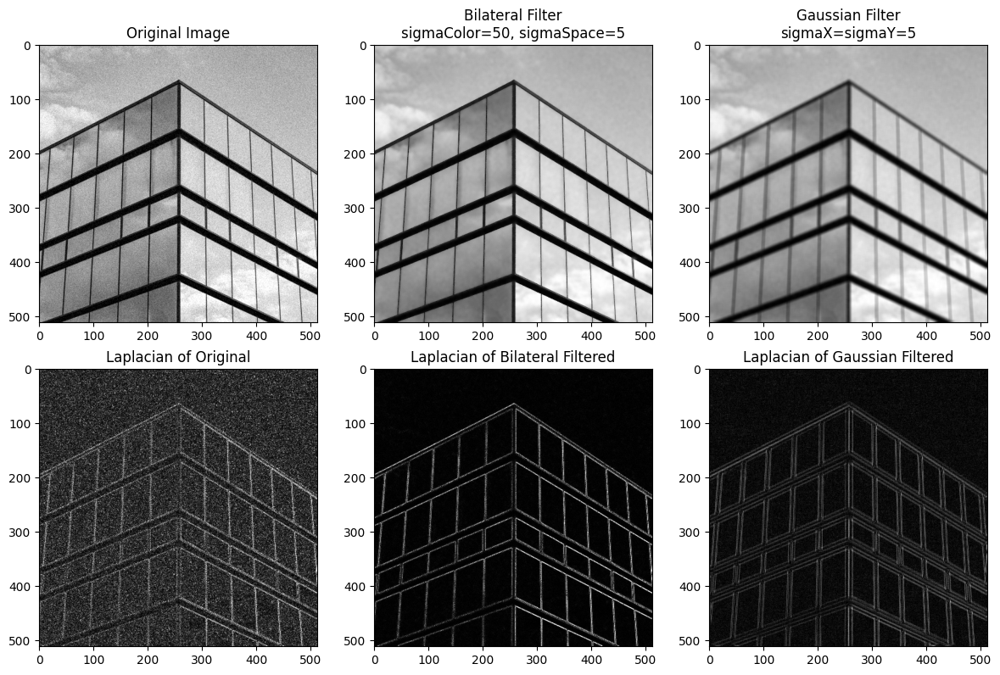

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

start = datetime.now()

def bilateral_filter(image, diameter, sigma_color, sigma_space):

    # Ensure image is a float array for computation
    image = image.astype(np.float32)
    filtered_image = np.zeros_like(image)

    # Define window size and generate the spatial Gaussian kernel
    half_diameter = diameter // 2
    x, y = np.meshgrid(np.arange(-half_diameter, half_diameter + 1), 
                       np.arange(-half_diameter, half_diameter + 1))
    spatial_weights = np.exp(-(x**2 + y**2) / (2 * sigma_space**2))

    # Pad the image to handle borders
    padded_image = np.pad(image, ((half_diameter, half_diameter), (half_diameter, half_diameter)), mode='reflect')

    # Iterate through each pixel in the original image
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            # Extract the region around the pixel in the padded image
            region = padded_image[i:i+diameter, j:j+diameter]

            # Calculate intensity weights based on the center pixel's intensity
            intensity_weights = np.exp(-((region - image[i, j]) ** 2) / (2 * sigma_color ** 2))

            # Combine spatial and intensity weights
            weights = spatial_weights * intensity_weights

            # Normalize weights and compute the new pixel value
            weights /= np.sum(weights)
            filtered_image[i, j] = np.sum(region * weights)

    return filtered_image.astype(np.uint8)


# Load the noisy image
img = cv2.imread('building_noisy.png', cv2.IMREAD_GRAYSCALE)
if img is None:
    print("Error: Image not found. Please check the file path.")
else:
    # Define different sigma_space and sigma_color values
    sigma_spaces = [0.5, 1, 3, 5]       # Different values for spatial filtering range
    sigma_colors = [20, 30, 40, 50]     # Different values for color intensity range

    # Loop over different parameter values and apply both filters
    for sigma_space in sigma_spaces:
        for sigma_color in sigma_colors:
            # Apply Bilateral Filter with varying sigma_space and sigma_color
            bilateral_filtered = bilateral_filter(img, diameter=7, sigma_color=sigma_color, sigma_space=sigma_space)
            
            # Apply Gaussian Smoothing with the same sigma_space as the Gaussian kernel sigma
            gaussian_smoothed = cv2.GaussianBlur(img, (7, 7), sigmaX=sigma_space, sigmaY=sigma_space)
            
            # Calculate the Laplacian for original, bilateral-filtered, and Gaussian-smoothed images
            laplace_original = cv2.Laplacian(img, cv2.CV_64F)
            laplace_bilateral = cv2.Laplacian(bilateral_filtered, cv2.CV_64F)
            laplace_gaussian = cv2.Laplacian(gaussian_smoothed, cv2.CV_64F)

            # Convert Laplacian results to uint8 format for consistent display
            laplace_original = cv2.convertScaleAbs(laplace_original)
            laplace_bilateral = cv2.convertScaleAbs(laplace_bilateral)
            laplace_gaussian = cv2.convertScaleAbs(laplace_gaussian)

            # Create a 2x3 plot with the specified layout
            plt.figure(figsize=(12, 8))
            
            # Top row: Original, Bilateral Filtered, Gaussian Filtered
            plt.subplot(2, 3, 1)
            plt.imshow(img, cmap='gray')
            plt.title('Original Image')
            
            plt.subplot(2, 3, 2)
            plt.imshow(bilateral_filtered, cmap='gray')
            plt.title(f'Bilateral Filter\nsigmaColor={sigma_color}, sigmaSpace={sigma_space}')
            
            plt.subplot(2, 3, 3)
            plt.imshow(gaussian_smoothed, cmap='gray')
            plt.title(f'Gaussian Filter\nsigmaX=sigmaY={sigma_space}')
            
            # Bottom row: Laplacian of Original, Bilateral, Gaussian Filtered Images
            plt.subplot(2, 3, 4)
            plt.imshow(laplace_original, cmap='gray')
            plt.title('Laplacian of Original')
            
            plt.subplot(2, 3, 5)
            plt.imshow(laplace_bilateral, cmap='gray')
            plt.title('Laplacian of Bilateral Filtered')
            
            plt.subplot(2, 3, 6)
            plt.imshow(laplace_gaussian, cmap='gray')
            plt.title('Laplacian of Gaussian Filtered')
            
            plt.tight_layout()

            # Display the combined figure
            plt.show()


In comparison to Gaussian filtering, the bilateral filter provides sharper edges at the same value of spatial standard deviation (sigma_space). For a fixed sigma_space, the edges in the image processed with the bilateral filter are better preserved than those in the Gaussian-filtered image. However, at lower values of the intensity standard deviation (sigma_color), the bilateral-filtered image tends to exhibit more noise than the Gaussian-filtered image.

As we increase sigma_color, this noise gradually reduces because higher sigma_color values allow greater intensity variation in the neighborhood, which helps to smooth out noise without significantly blurring edges.

The difference between these two filters lies in their weighting mechanisms. While Gaussian filtering applies weights based only on spatial proximity, the bilateral filter combines spatial proximity and intensity similarity. A lower sigma_color places more weight on pixels with similar intensities to the central pixel, resulting in edge preservation but potentially allowing high-frequency noise to pass through. As sigma_space increases, the bilateral filter’s effect approaches that of Gaussian filtering, where edges are smoothed out along with noise.

Overall, the bilateral filter is effective for edge-preserving smoothing, as it selectively blurs regions while maintaining sharp transitions at edges, which is crucial in applications where edge details are important.

# Question 2

In [2]:
import cv2
import numpy as np

def add_noise_and_save(image_path, noise_levels, output_prefix="Hough_Coins_Noisy"):
    # Load the image
    img = cv2.imread(image_path)
    # Convert to grayscale
    grayscale_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Add noise and save images
    for noise_count in noise_levels:
        noisy_img = np.copy(grayscale_img)
        for _ in range(noise_count):
            x = np.random.randint(0, noisy_img.shape[0])
            y = np.random.randint(0, noisy_img.shape[1])
            noisy_img[x, y] = 255
        # Save the noisy image
        output_filename = f"{output_prefix}_{noise_count}.jpg"
        cv2.imwrite(output_filename, noisy_img)
        print(f"Saved: {output_filename}")

# Define noise levels
noise_levels = [10000, 20000, 30000, 40000, 50000]

# Call the function
add_noise_and_save("Hough_Coins.jpg", noise_levels)


Saved: Hough_Coins_Noisy_10000.jpg
Saved: Hough_Coins_Noisy_20000.jpg
Saved: Hough_Coins_Noisy_30000.jpg
Saved: Hough_Coins_Noisy_40000.jpg
Saved: Hough_Coins_Noisy_50000.jpg


Processing Hough_Coins.jpg


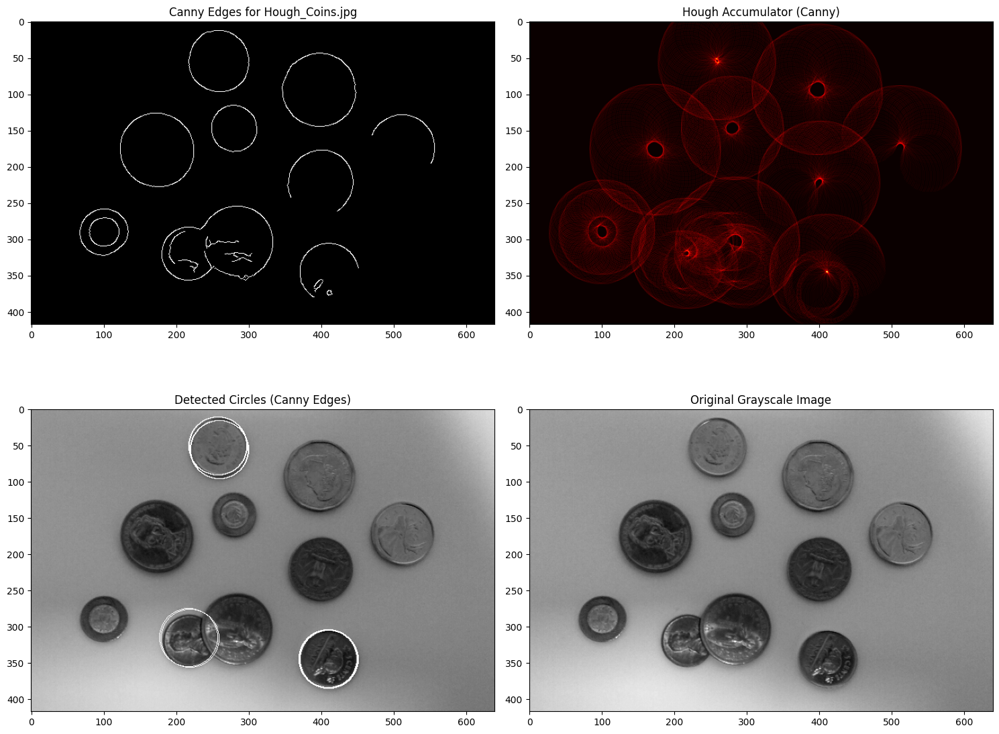

Processing Hough_Coins_Noisy_10000.jpg


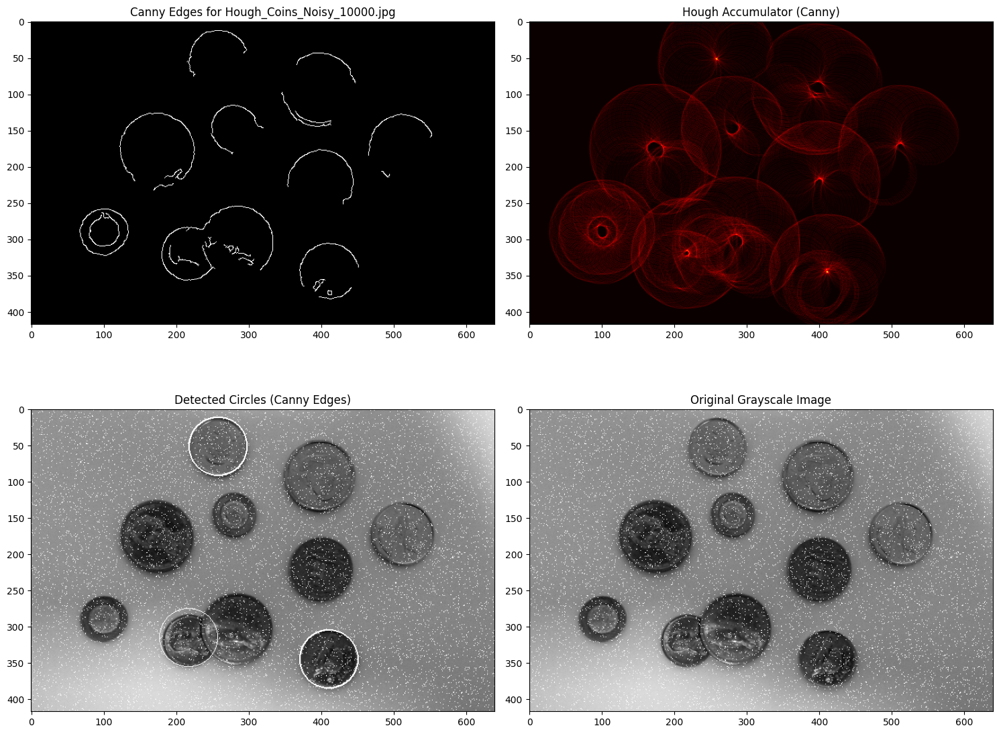

Processing Hough_Coins_Noisy_20000.jpg


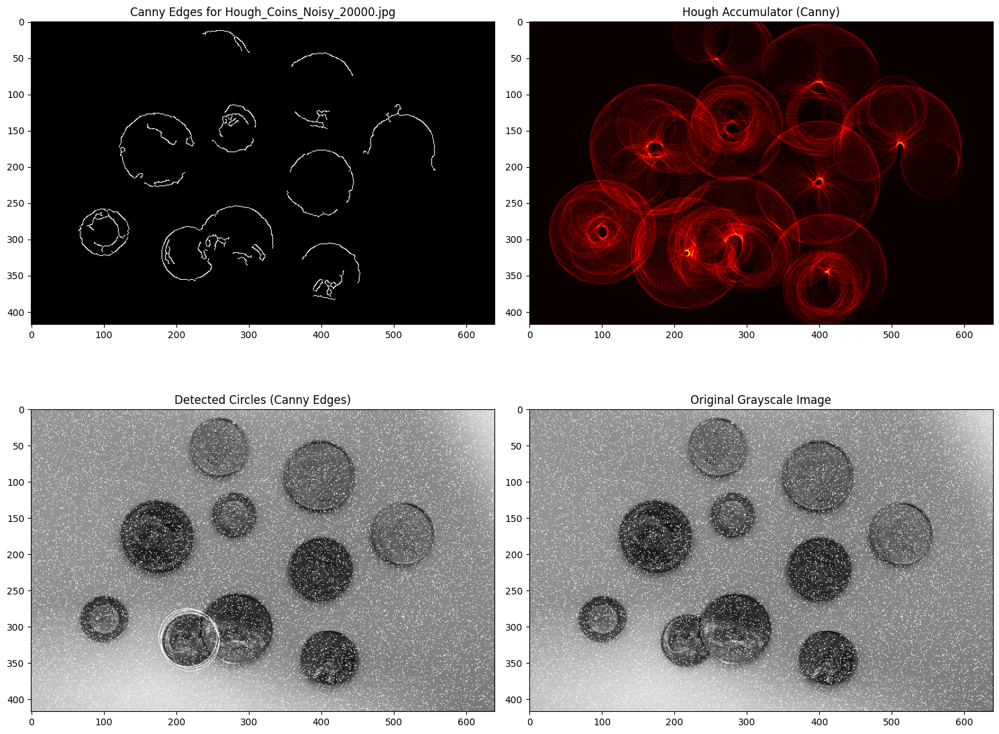

Processing Hough_Coins_Noisy_30000.jpg


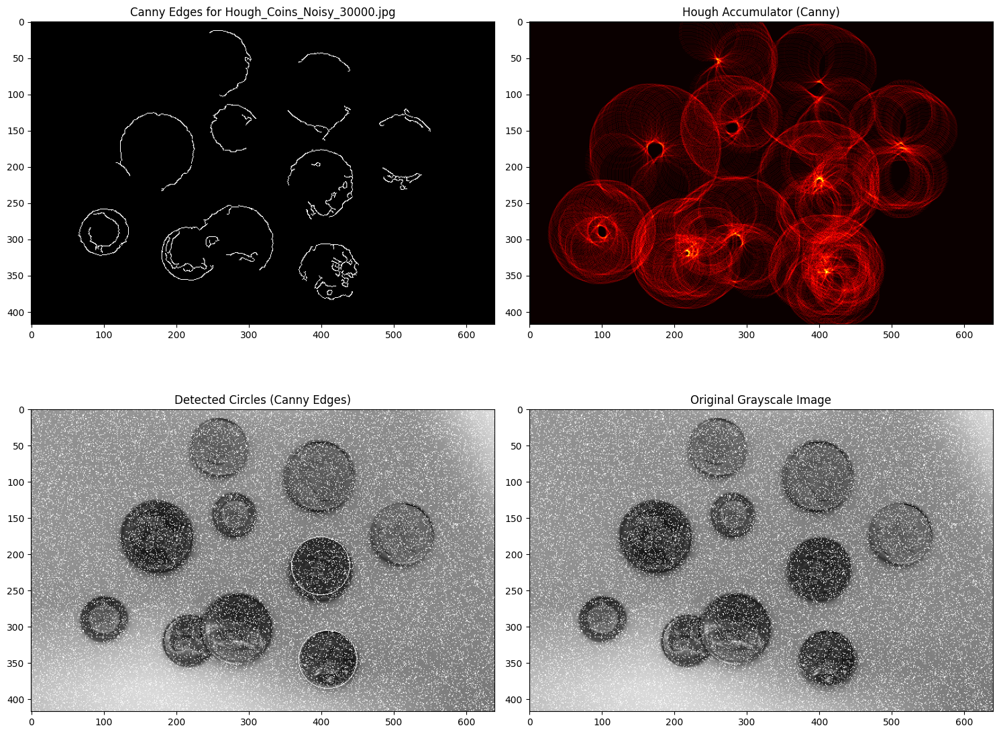

Processing Hough_Coins_Noisy_40000.jpg


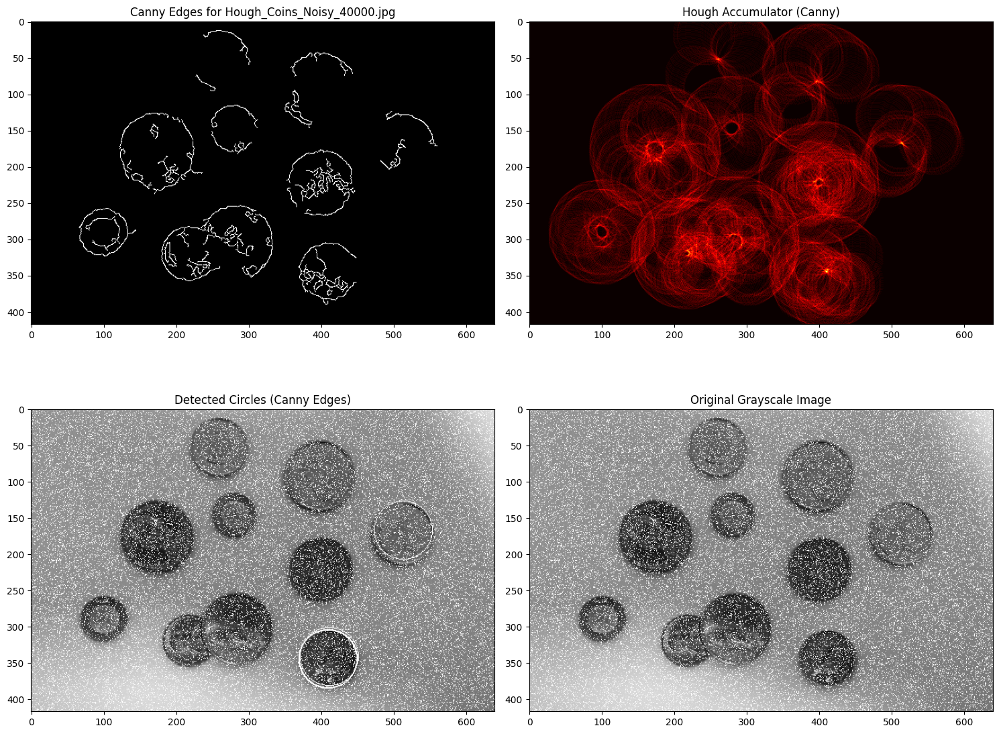

Processing Hough_Coins_Noisy_50000.jpg


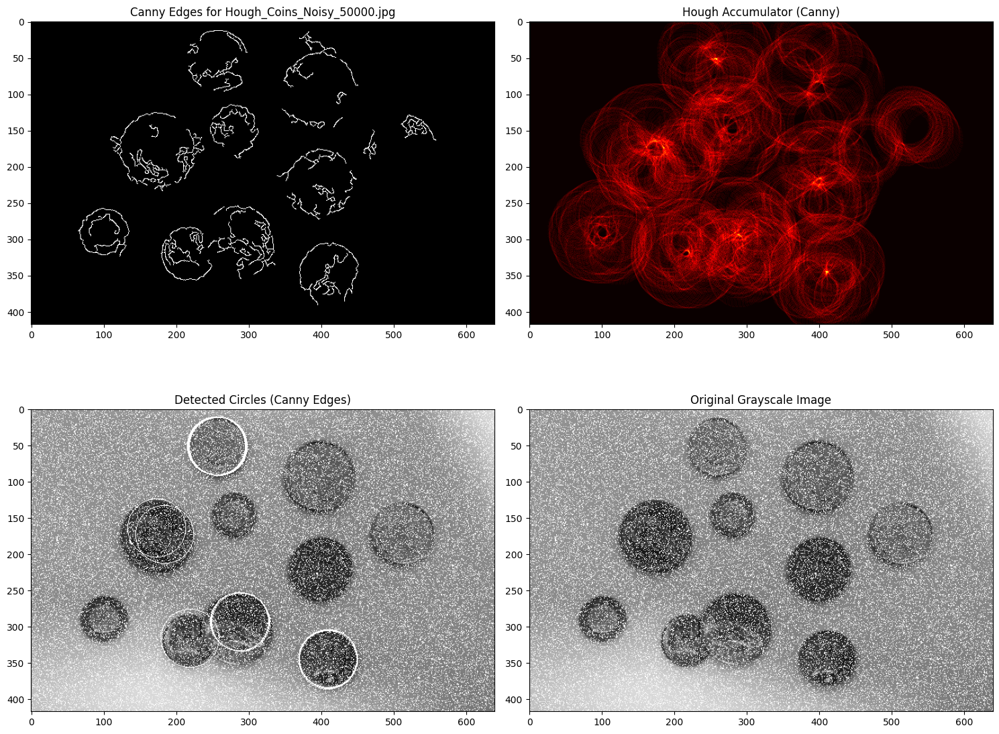

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage import draw

# Vectorized Hough Transform for Circle Detection
def hough_transform_circle(image, radius, threshold=10):
    """Detects circles of a specific radius using the Hough Transform."""
    
    # Initialize Hough accumulator
    hough_accumulator = np.zeros((image.shape[0], image.shape[1]))
    
    # Precompute sin and cos for angles
    theta = np.linspace(0, 2 * np.pi, 100)
    cos_theta = radius * np.cos(theta)
    sin_theta = radius * np.sin(theta)
    
    # Get edge points
    edge_points = np.column_stack(np.nonzero(image))
    
    # Use broadcasting to compute all circle centers
    for x, y in edge_points:
        a_values = (x - cos_theta).astype(int)
        b_values = (y - sin_theta).astype(int)
        
        # Only keep points within image bounds
        valid_indices = (0 <= a_values) & (a_values < image.shape[0]) & \
                        (0 <= b_values) & (b_values < image.shape[1])
        
        hough_accumulator[a_values[valid_indices], b_values[valid_indices]] += 1

    # Find centers above threshold
    detected_circles = np.column_stack(np.nonzero(hough_accumulator > threshold))

    return detected_circles, hough_accumulator


def process_image(filename, radius_vector):
    # Load image and convert to grayscale
    img = cv2.imread(filename)
    grayscale_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred_img = cv2.GaussianBlur(grayscale_img, (9, 9), 2)

    # Edge detection using Canny operator
    edges_canny = cv2.Canny(blurred_img, 20, 120)

    # Prepare image for detected circles
    detected_image_canny = np.copy(grayscale_img)

    # Apply Hough Transform and get accumulators for Canny edges
    for radius in radius_vector:
        detected_circles_canny, accumulator_canny = hough_transform_circle(edges_canny, radius=radius, threshold=23)

        # Draw circles for detected centers from Canny edges
        for center in detected_circles_canny:
            rr, cc = draw.circle_perimeter(center[0], center[1], radius, shape=grayscale_img.shape)
            detected_image_canny[rr, cc] = 255

    # Display results
    fig, ax = plt.subplots(2, 2, figsize=(15, 12))

    # Display edges detected by Canny
    ax[0, 0].imshow(edges_canny, cmap='gray')
    ax[0, 0].set_title(f'Canny Edges for {filename}')

    # Display Hough Accumulator for Canny edge-detected image
    ax[0, 1].imshow(accumulator_canny, cmap='hot')
    ax[0, 1].set_title('Hough Accumulator (Canny)')

    # Display detected circles for Canny edges
    ax[1, 0].imshow(detected_image_canny, cmap='gray')
    ax[1, 0].set_title('Detected Circles (Canny Edges)')

    # Display original grayscale image for reference
    ax[1, 1].imshow(grayscale_img, cmap='gray')
    ax[1, 1].set_title('Original Grayscale Image')

    plt.tight_layout()
    plt.show()

# Example usage
noise_levels = [0, 10000, 20000, 30000, 40000, 50000]
radius_vector = np.array( [40])

for noise_level in noise_levels:
    if noise_level == 0:
        filename = "Hough_Coins.jpg"
        print(f"Processing {filename}")
        process_image(filename, radius_vector)
    else:
        filename = f"Hough_Coins_Noisy_{noise_level}.jpg"
        print(f"Processing {filename}")
        process_image(filename, radius_vector)

Processing radius: 30


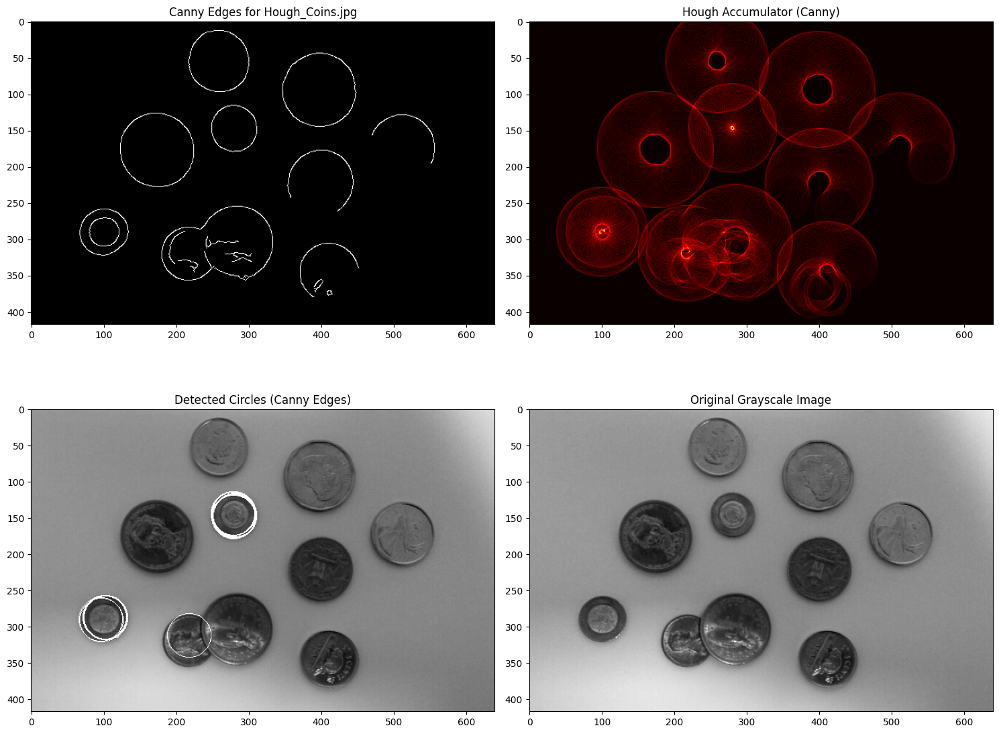

Processing radius: 35


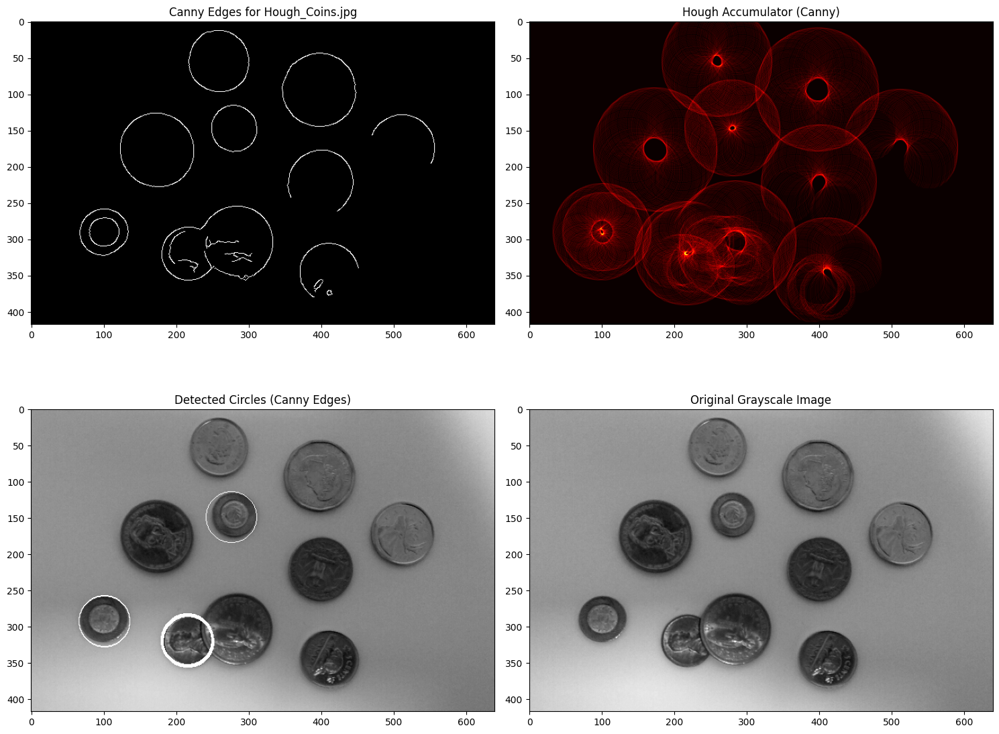

Processing radius: 40


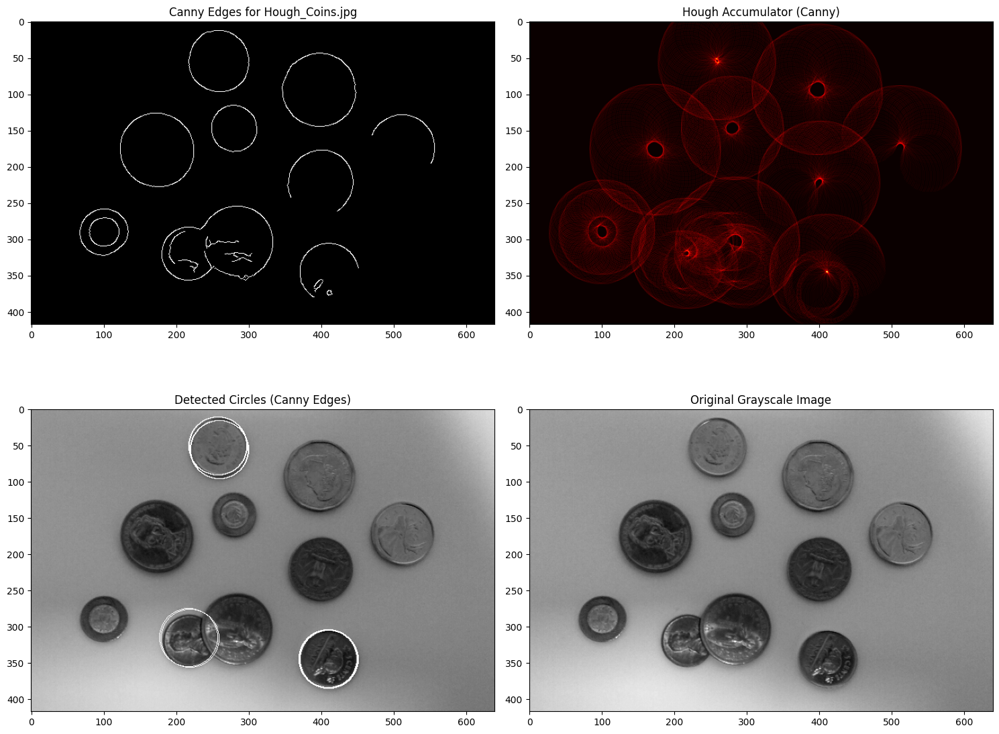

Processing radius: 45


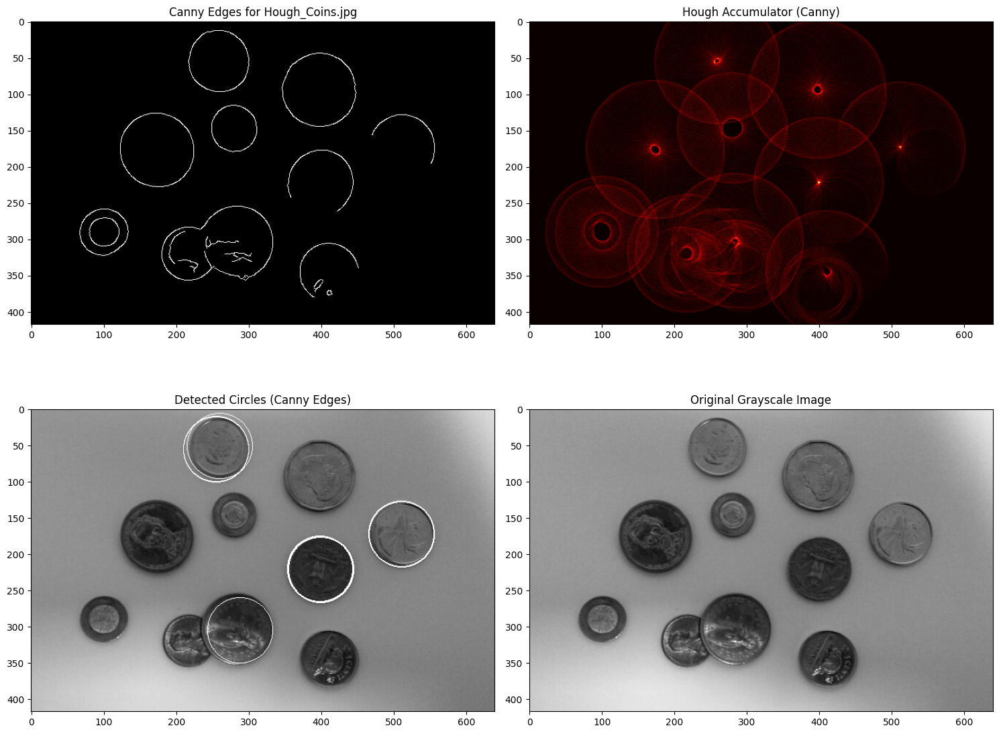

Processing radius: 50


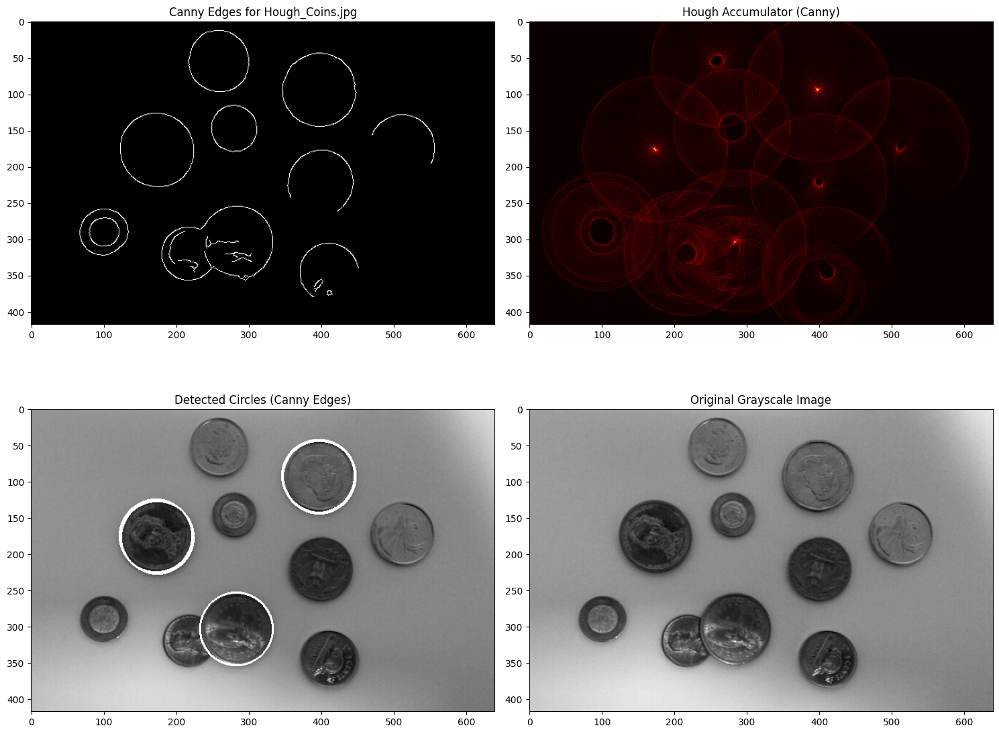

In [4]:
#Varying the radius of the circle
radius_vector = np.array([30,35, 40,45, 50])
for radius in radius_vector:
    print(f"Processing radius: {radius}")
    process_image("Hough_Coins.jpg", np.array([radius]))

(i) High noise makes it difficult to detect the coins. As noise levels increase, noise boundaries are created, which can corrupt the Hough accumulator, leading to false positive and false negative detections of coins.

(ii) & (iii) If we set a radius \( r = 30 \), only circles with radii close to 30 will be detected. Similarly, if we set \( r = 90 \) and the image contains only smaller circles, none will be detected. Therefore, it’s essential to use a range of radius values. By detecting circles across various radii, we can capture all circles in the image, ensuring that objects of different sizes are identified.

From these results, it can be concluded that for varying radius values, the occluded coins are more easily detected when the radius is set equal to their actual radius in this specific example.

# Q2 (b)

Processing Hough_Coins.jpg


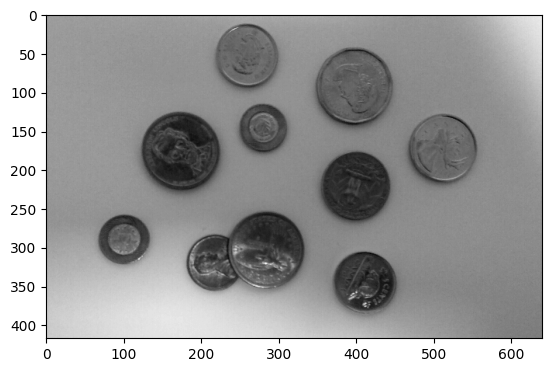

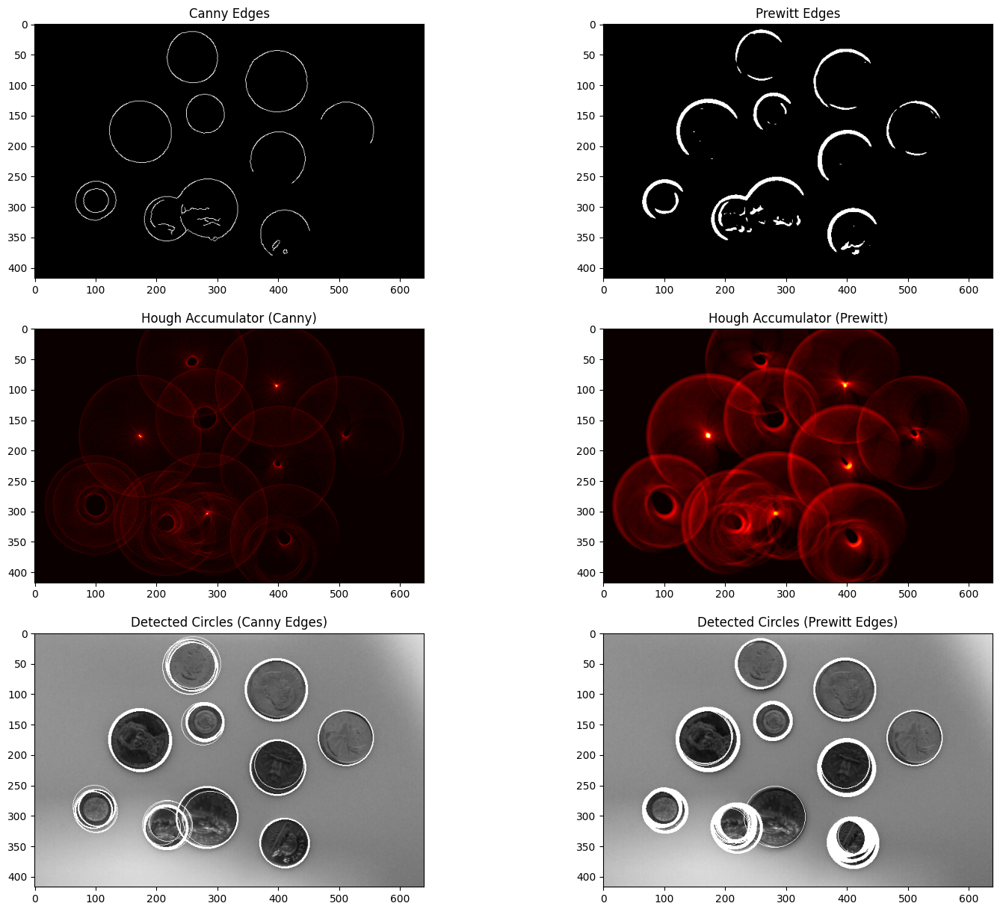

Processing Hough_Coins_Noisy_10000.jpg


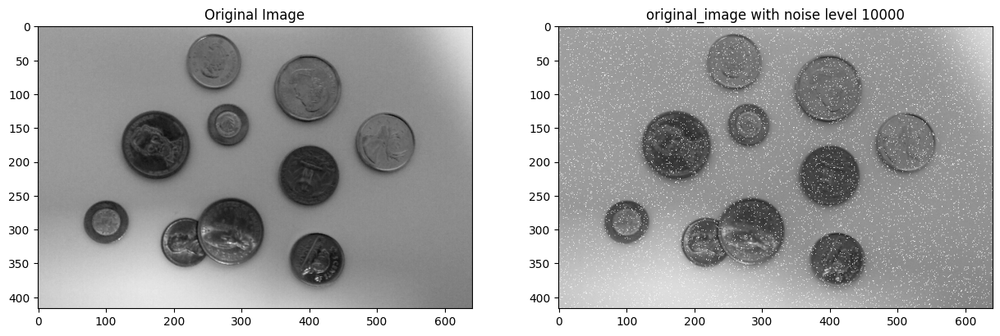

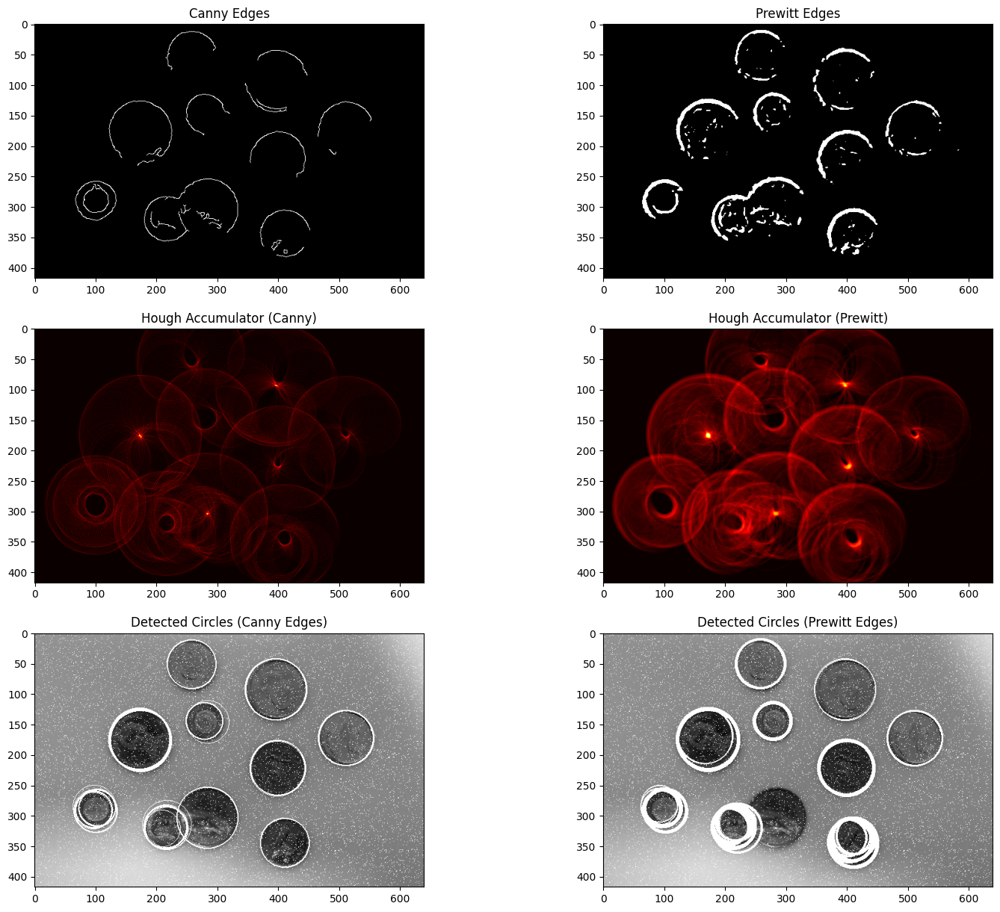

Processing Hough_Coins_Noisy_20000.jpg


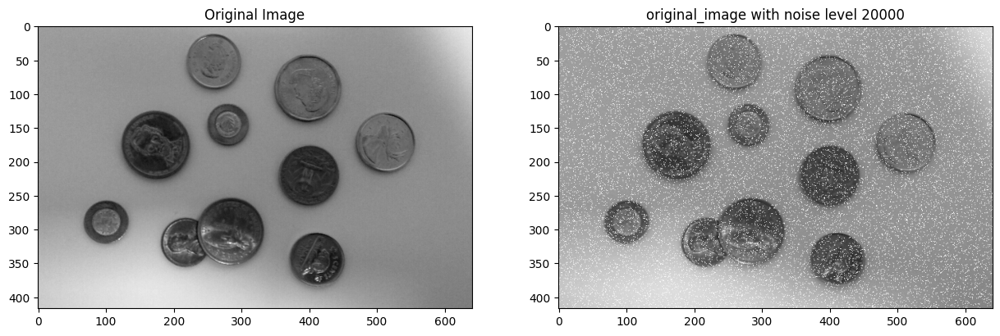

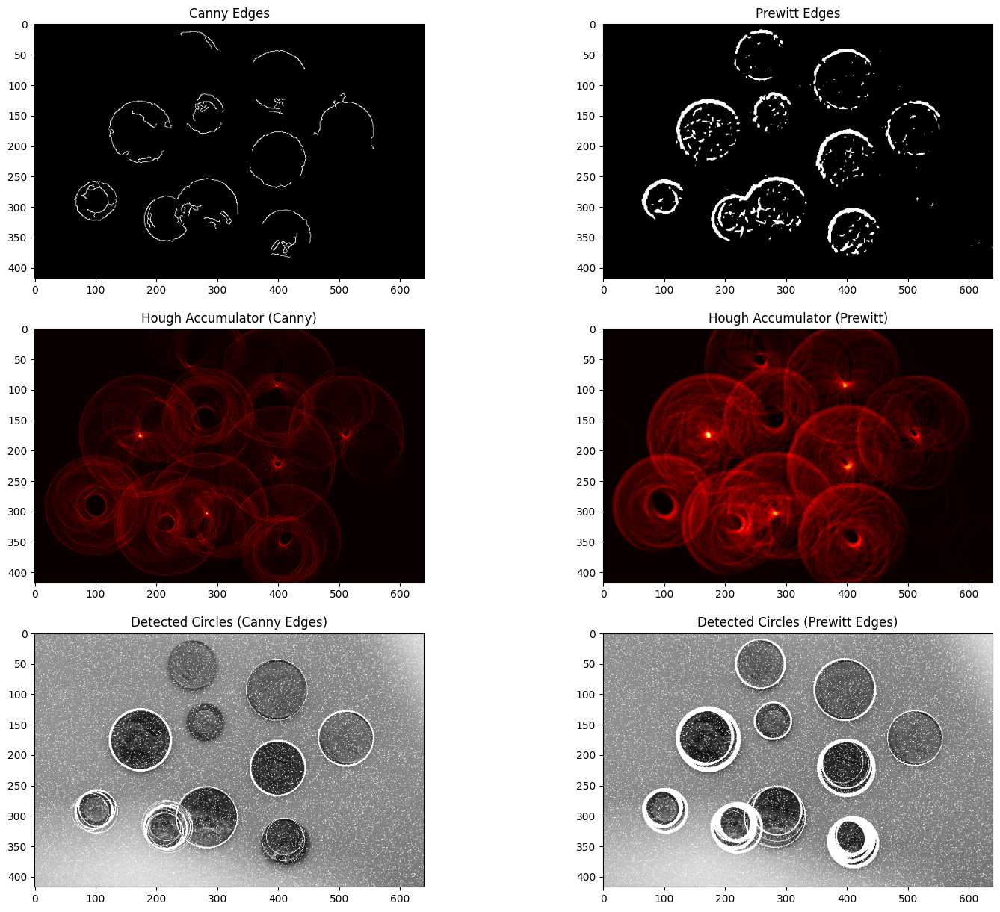

Processing Hough_Coins_Noisy_30000.jpg


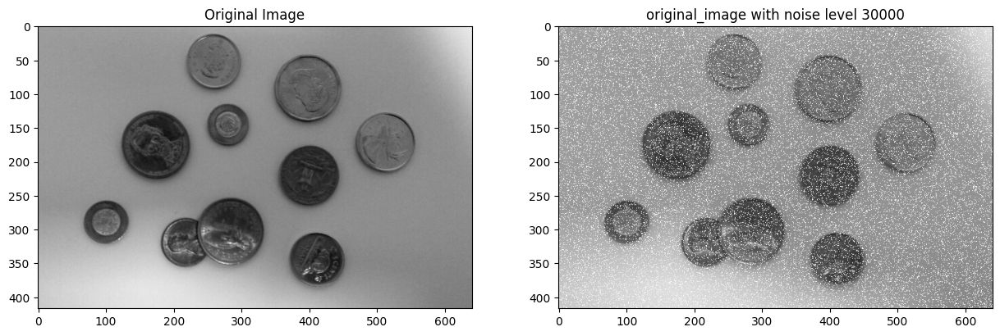

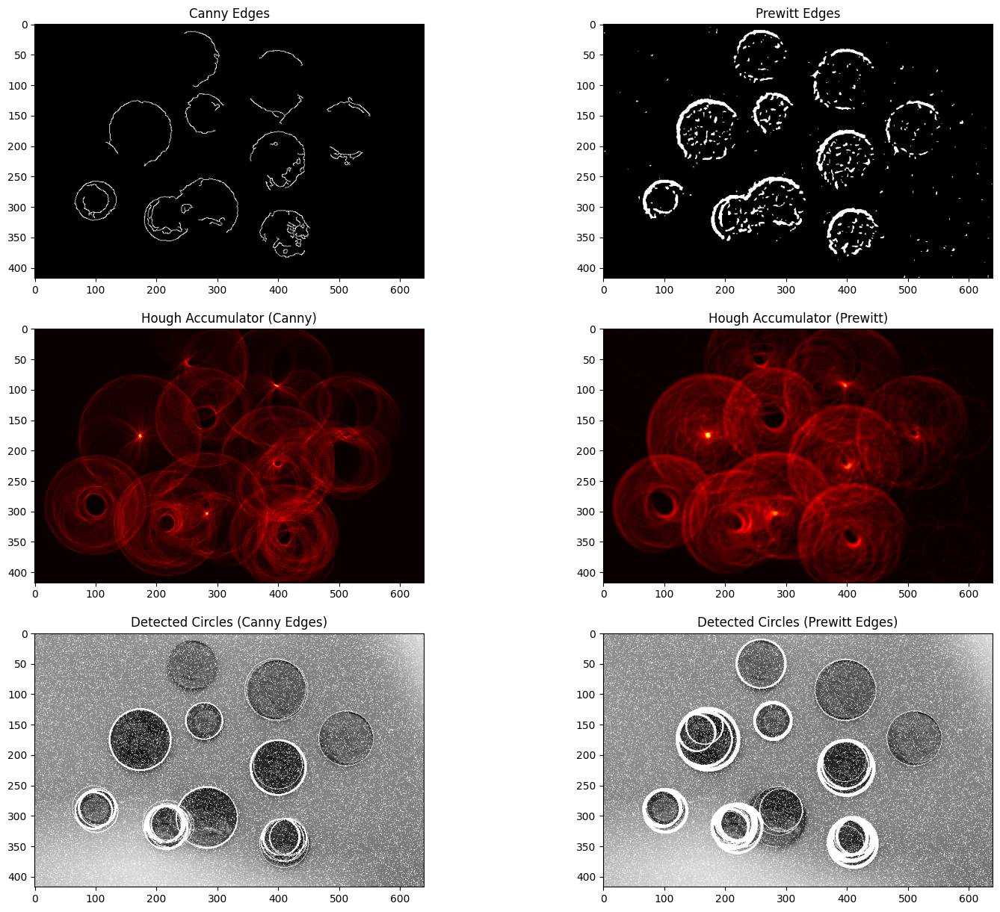

Processing Hough_Coins_Noisy_40000.jpg


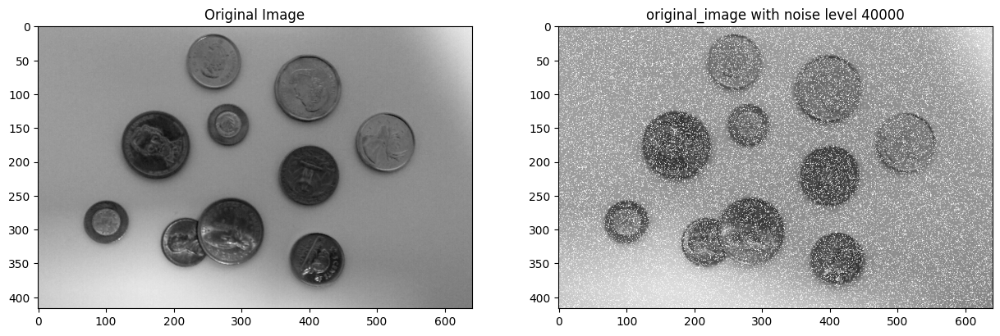

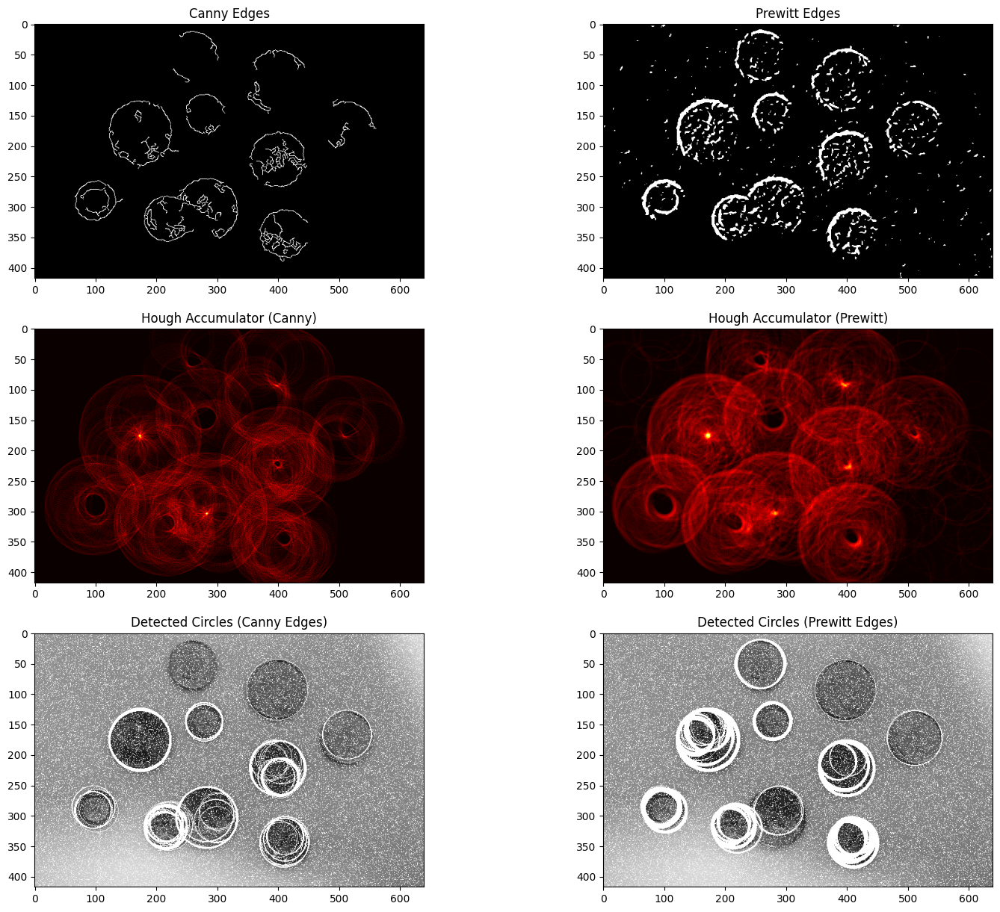

Processing Hough_Coins_Noisy_50000.jpg


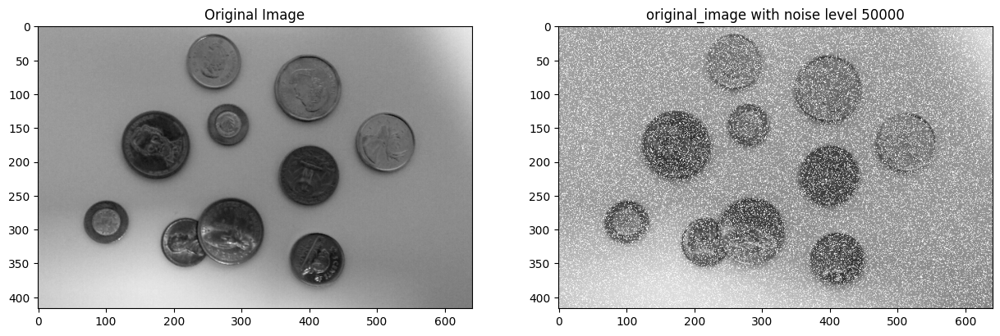

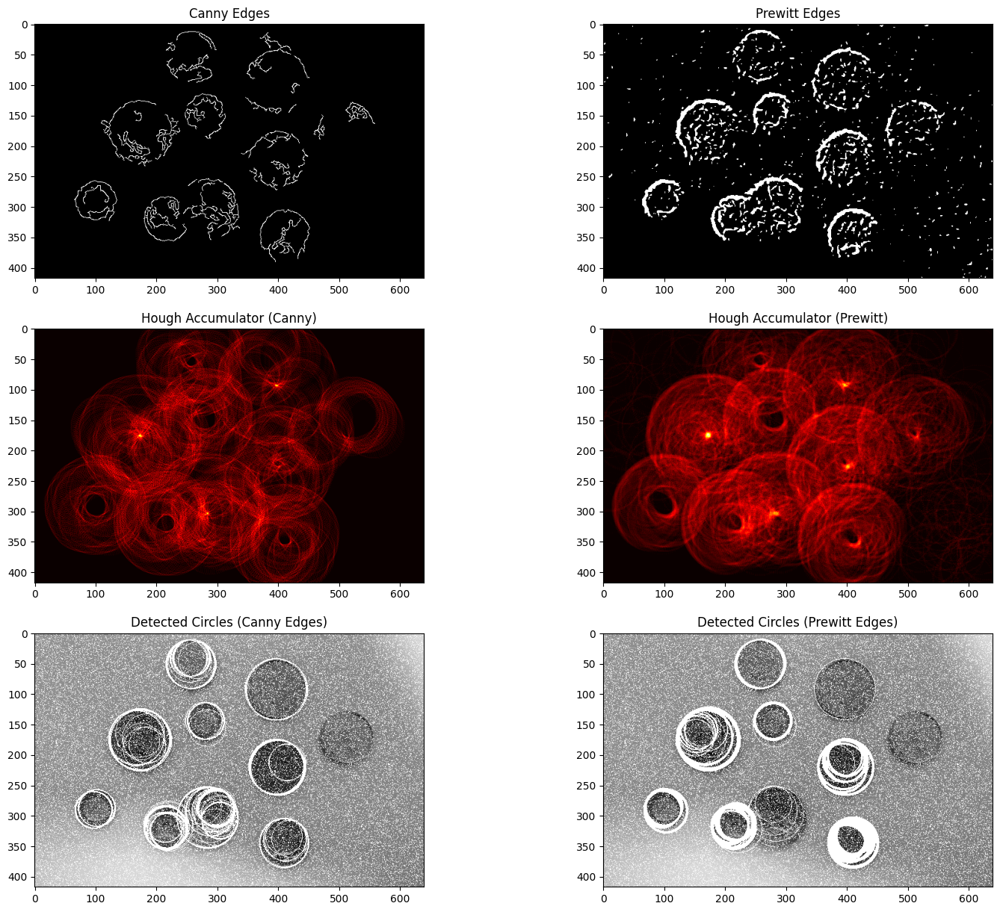

In [5]:
import cv2
import numpy as np
from skimage import draw

import matplotlib.pyplot as plt

def process_image_1(filename, radius_vector):
    # Load image and convert to grayscale
    img = cv2.imread(filename)
    grayscale_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred_img = cv2.GaussianBlur(grayscale_img, (9, 9), 2)

    # Edge detection using Canny and Prewitt operators
    edges_canny = cv2.Canny(blurred_img, 20, 120)

    # Prewitt Edge Detection
    prewitt_x = cv2.filter2D(blurred_img, -1, np.array([[1, 0, -1], [1, 0, -1], [1, 0, -1]]))
    prewitt_y = cv2.filter2D(blurred_img, -1, np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]]))
    edges_prewitt = cv2.magnitude(prewitt_x.astype(np.float64), prewitt_y.astype(np.float64)).astype(np.uint8)
    _, edges_prewitt = cv2.threshold(edges_prewitt, 30, 255, cv2.THRESH_BINARY)

    detected_image_canny = np.copy(grayscale_img)
    detected_image_prewitt = np.copy(grayscale_img)

    # Apply Hough Transform and get accumulators for Canny and Prewitt edges
    for radius in radius_vector:
        detected_circles_canny, accumulator_canny = hough_transform_circle(edges_canny, radius=radius, threshold=22)
        detected_circles_prewitt, accumulator_prewitt = hough_transform_circle(edges_prewitt, radius=radius, threshold=43)

        # Draw circles for detected centers from Canny edges
        for center in detected_circles_canny:
            rr, cc = draw.circle_perimeter(center[0], center[1], radius, shape=grayscale_img.shape)
            detected_image_canny[rr, cc] = 255

        # Draw circles for detected centers from Prewitt edges
        for center in detected_circles_prewitt:
            rr, cc = draw.circle_perimeter(center[0], center[1], radius, shape=grayscale_img.shape)
            detected_image_prewitt[rr, cc] = 255


    # Display results
    fig, ax = plt.subplots(3, 2, figsize=(18, 15))

    # Display edges detected by Canny and Prewitt
    ax[0, 0].imshow(edges_canny, cmap='gray')
    ax[0, 0].set_title('Canny Edges')

    ax[0, 1].imshow(edges_prewitt, cmap='gray')
    ax[0, 1].set_title('Prewitt Edges')

    # Display Hough Accumulators for Canny and Prewitt edge-detected images
    ax[1, 0].imshow(accumulator_canny, cmap='hot')
    ax[1, 0].set_title('Hough Accumulator (Canny)')

    ax[1, 1].imshow(accumulator_prewitt, cmap='hot')
    ax[1, 1].set_title('Hough Accumulator (Prewitt)')

    # Display detected circles for Canny and Prewitt edges
    ax[2, 0].imshow(detected_image_canny, cmap='gray')
    ax[2, 0].set_title('Detected Circles (Canny Edges)')

    ax[2, 1].imshow(detected_image_prewitt, cmap='gray')
    ax[2, 1].set_title('Detected Circles (Prewitt Edges)')
    plt.show()

original_imag =cv2.imread("Hough_Coins.jpg")
grayscale_img = cv2.cvtColor(original_imag, cv2.COLOR_BGR2GRAY)
noise_levels = [0, 10000, 20000, 30000, 40000, 50000]

for noise_level in noise_levels:
    if noise_level == 0:
        filename = "Hough_Coins.jpg"
        plt.imshow(grayscale_img, cmap='gray')
        print(f"Processing {filename}")
        process_image_1(filename, radius_vector)
    else:
        filename = f"Hough_Coins_Noisy_{noise_level}.jpg"
        fig, axs = plt.subplots(1, 2, figsize=(15, 12))
        axs[0].imshow(grayscale_img, cmap='gray')
        axs[0].set_title(f"Original Image")
        axs[1].imshow(cv2.imread(filename))
        axs[1].set_title(f"original_image with noise level {noise_level}")

        print(f"Processing {filename}")
        process_image_1(filename, radius_vector)


# Conclusion 2(b)

Based on the analysis of the image, we conclude that circles detected using the Prewitt and Canny edge detection methods are susceptible to noise, with the circles detected by Prewitt edge detection being especially more noise-prone than those detected by Canny edge detection.

For these detections, a threshold of 30 was used for Prewitt edge detection, while thresholds of 20 and 120 were applied for Canny edge detection. To effectively detect circles, the threshold values for the Hough transform accumulator were set to 22 for Canny edge detection and 43 for Prewitt edge detection, determined through trial and error.

If a lower threshold is set for the Hough accumulator, it results in the detection of numerous circles, including overlapping circles. Conversely, if the threshold is set too high, no circles will be detected.

In the example image “Hough_Coins.jpg,” there is occlusion of objects, where part of one coin overlaps another. Despite this, the Hough transform can detect circles since some fractional parts of the coins are still visible. However, the threshold needed to detect these occluded circles will be relatively low.


In [6]:
end = datetime.now()

print(end - start)

0:02:27.829569
